In [1]:
from collections import namedtuple
from torchaudio import transforms
from IPython.display import Audio

from pathlib import Path
import torch
import torchaudio
import librosa
import librosa.display
import numpy as np
import random
import matplotlib.pyplot as plt

### Check Audio

In [2]:
def check_audio(aud):
    display(Audio(data = aud.sig, rate = aud.sr))

In [16]:
if __name__ == '__main__':


    dataset = Path('dataset').glob('*.wav')

    for audio_path in dataset:
        AudioData = namedtuple('AudioData', ['sig', 'sr'])
        audio = AudioData(*torchaudio.load(audio_path))

check_audio(audio)

### Audio Augmentation

In [4]:
class SpectrogramToDB(object):
    """Turns a spectrogram from the power/amplitude scale to the decibel scale.
    This output depends on the maximum value in the input spectrogram, and so
    may return different values for an audio clip split into snippets vs. a
    a full clip. This method is sourced from an earlier release of torchaudio and
    is no longer present in current versions.
    Args:
        stype (str): scale of input spectrogram ("power" or "magnitude").  The
            power being the elementwise square of the magnitude. default: "power"
        top_db (float, optional): minimum negative cut-off in decibels.  A reasonable number
            is 80.
    """
    def __init__(self, stype="power", top_db=None):
        self.stype = stype
        if top_db is not None and top_db < 0:
            raise ValueError('top_db must be positive value')
        self.top_db = top_db
        self.multiplier = 10. if stype == "power" else 20.
        self.amin = 1e-10
        self.ref_value = 1.
        self.db_multiplier = np.log10(np.maximum(self.amin, self.ref_value))

    def __call__(self, spec):
        
        # numerically stable implementation from librosa
        # https://librosa.github.io/librosa/_modules/librosa/core/spectrum.html
        
        spec_db = self.multiplier * torch.log10(torch.clamp(spec, min=self.amin))
        spec_db -= self.multiplier * self.db_multiplier

        if self.top_db is not None:
            spec_db = torch.max(spec_db, spec_db.new_full((1,), spec_db.max() - self.top_db))
        
        return spec_db

In [5]:
def tfm_spectro(aud:Audio, sr=16000, to_db_scale=False, n_fft=1024, 
                ws=None, hop=None, f_min=0.0, f_max=-80, pad=0, n_mels=128):
    
    # We must reshape signal for torchaudio to generate the spectrogram.
    mel = transforms.MelSpectrogram(sample_rate=aud.sr, n_mels=n_mels, n_fft=n_fft, win_length=ws, hop_length=hop, f_min=f_min, f_max=f_max, pad=pad)(aud.sig.reshape(1, -1))

    if to_db_scale: 
        mel = SpectrogramToDB(stype='magnitude', top_db=f_max)(mel)

    return mel

In [6]:
spectro = tfm_spectro(audio, ws=512, hop=256, n_mels=128, to_db_scale=True, f_max=8000, f_min=-80)

### Spectogram Viewer

In [7]:
def tensor_to_img(spectrogram, title):
    plt.figure(figsize=(15,5)) # arbitrary, looks good on my screen.
    plt.title(f'{title}', size = 15)
    librosa.display.specshow(np.array(spectrogram[0]))
    plt.colorbar()

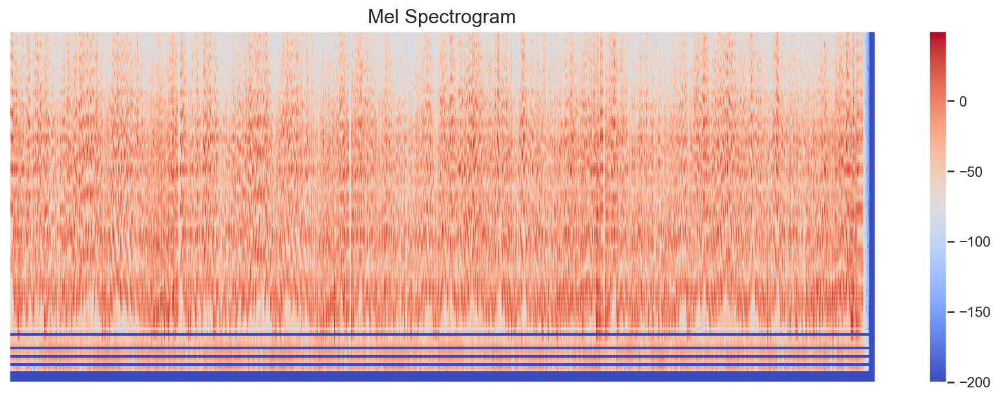

In [8]:
tensor_to_img(spectro,'Mel Spectrogram')

### Frequency Mask

In [9]:
def freq_mask(spec, F=30, num_masks=1, replace_with_zero=False):
    cloned = spec.clone()
    num_mel_channels = cloned.shape[1]
    
    for i in range(0, num_masks):        
        f = random.randrange(0, F)
        f_zero = random.randrange(0, num_mel_channels - f)

        # avoids randrange error if values are equal and range is empty
        if (f_zero == f_zero + f): return cloned

        mask_end = random.randrange(f_zero, f_zero + f) 
        if (replace_with_zero): cloned[0][f_zero:mask_end] = 0
        else: cloned[0][f_zero:mask_end] = cloned.mean()
    
    return cloned

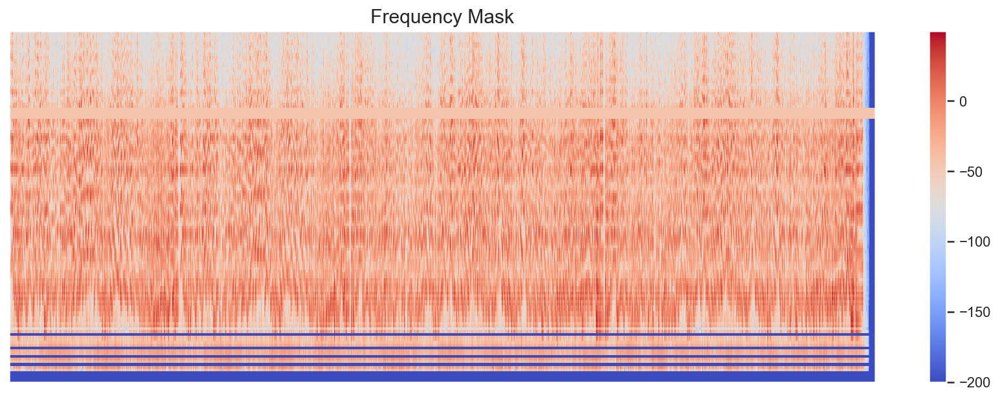

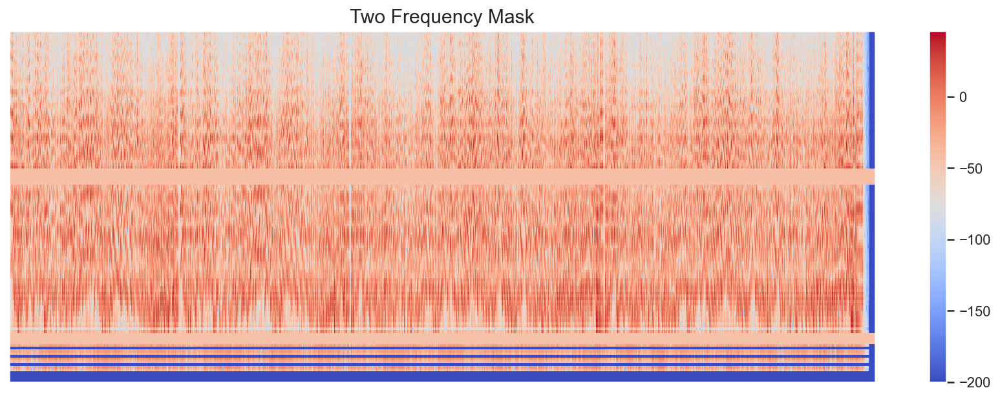

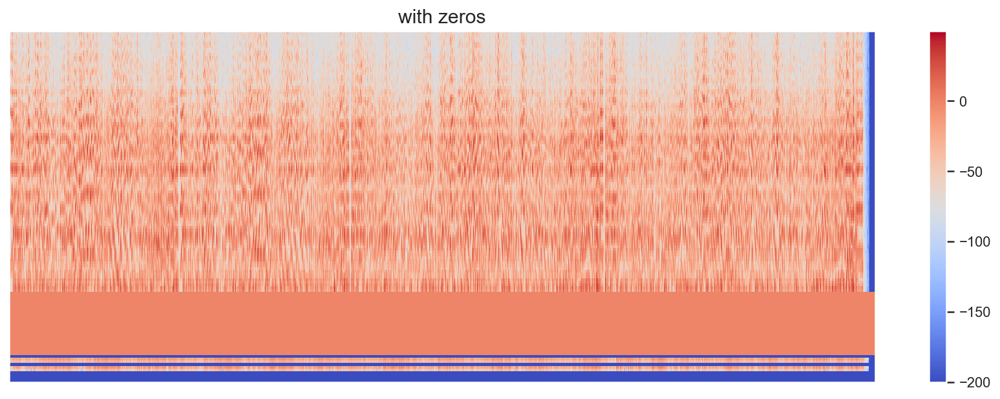

In [10]:
def test_freq_mask():
    tensor_to_img(freq_mask(spectro),'Frequency Mask')
    tensor_to_img(freq_mask(spectro, num_masks=2),'Two Frequency Mask')
    tensor_to_img(freq_mask(spectro, num_masks=2, replace_with_zero=True),'with zeros')
test_freq_mask()

### Time Mask

In [11]:
def time_mask(spec, T=40, num_masks=1, replace_with_zero=False):
    cloned = spec.clone()
    len_spectro = cloned.shape[2]
    
    for i in range(0, num_masks):
        t = random.randrange(0, T)
        t_zero = random.randrange(0, len_spectro - t)

        # avoids randrange error if values are equal and range is empty
        if (t_zero == t_zero + t): return cloned

        mask_end = random.randrange(t_zero, t_zero + t)
        if (replace_with_zero): cloned[0][:,t_zero:mask_end] = 0
        else: cloned[0][:,t_zero:mask_end] = cloned.mean()
    return cloned

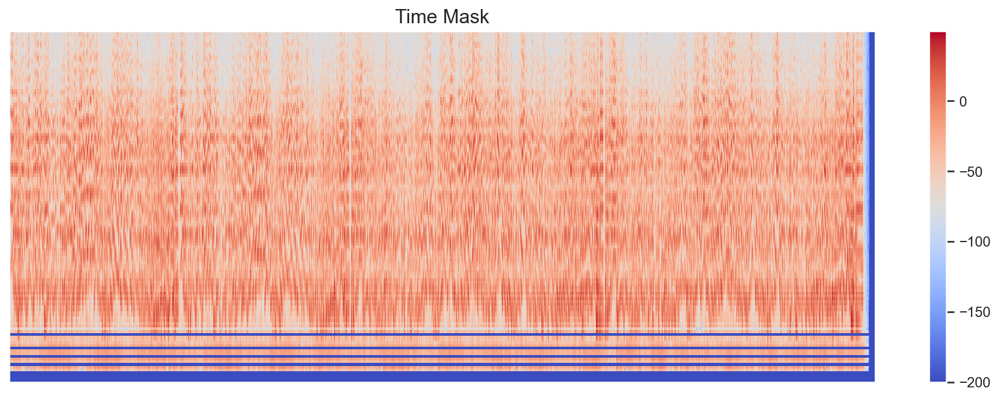

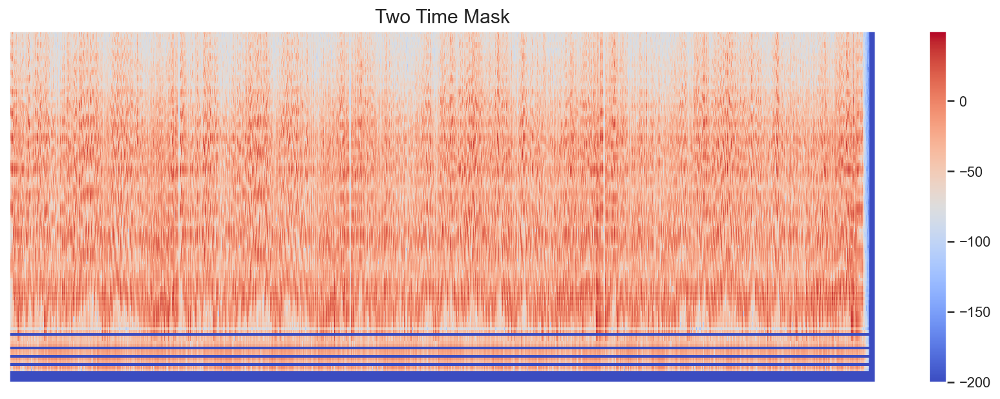

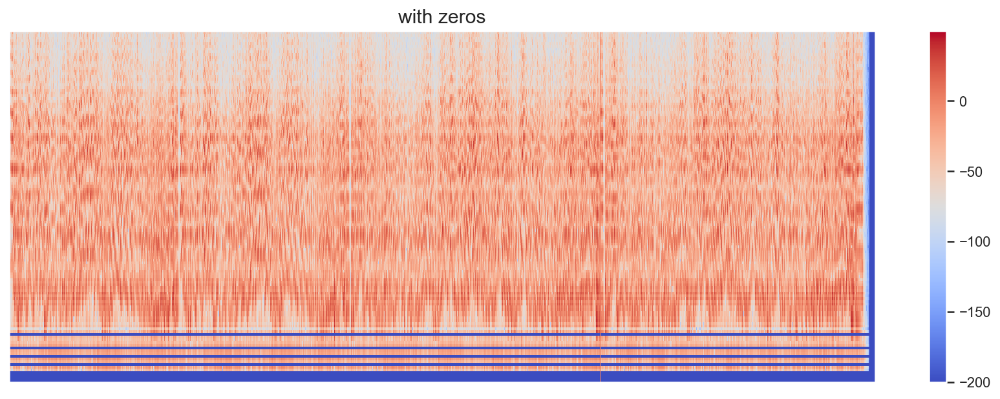

In [12]:
def test_time_mask():
    tensor_to_img(time_mask(spectro), 'Time Mask')
    tensor_to_img(time_mask(spectro, num_masks=2), 'Two Time Mask')
    tensor_to_img(time_mask(spectro, num_masks=2, replace_with_zero=True), "with zeros")
test_time_mask()

### Combined

In [13]:
combined = time_mask(freq_mask(spectro, num_masks=2), num_masks=2)

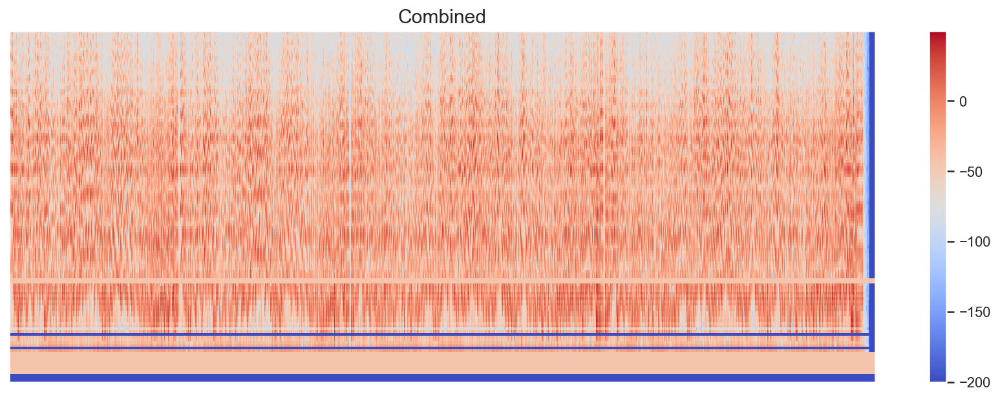

In [14]:
tensor_to_img(combined,'Combined')

---